This notebook is part of an exploratory analysis of machine learning used to decompose hyperspectral datasets of hybrid perovskite nanoscale materials.

Two machine learning models are primarily used: Nonnegative Matrix Factorization and Variational Autoencoders

**Notebook One: Preprocessing**

# Imports, Functions, Classes, and Colors

## Imports

In [1]:
import numpy as np
import random
import h5py
import matplotlib.pyplot as plt; plt.rcParams['figure.dpi'] = 300
import matplotlib as mpl
from matplotlib.gridspec import GridSpec
from matplotlib.ticker import MaxNLocator
from matplotlib.animation import FuncAnimation, ArtistAnimation
from celluloid import Camera
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
from typing import Optional, Union, List, Tuple
from scipy.ndimage import median_filter, gaussian_filter
from scipy.signal import find_peaks, savgol_filter
from skimage.restoration import denoise_wavelet

save_directory = "./png-figures/preprocessing/" # modify to save figures as a specified file extension
file_extension = ".png"

## Functions and Classes

In [2]:
def cropper(wavelength_file, spectra_file, shortwavelength, longwavelength):
    
    # This function allows us to crop all wavelengths below and above a specified value
    # Returns new wavelengths object and new spectra file
    
    if (
        shortwavelength < wavelength_file.min()
        or longwavelength > wavelength_file.max()
    ):
        print(
            "Desired wavelength exceeds range. Choose a value between {}nm and {}nm".format(
                wavelength_file.min(), wavelength_file.max()
            )
        )
        return

    y = []

    shortwavelengthindex = find_nearest(wavelength_file, shortwavelength)
    longwavelengthindex = find_nearest(wavelength_file, longwavelength)

    x = wavelength_file[shortwavelengthindex:longwavelengthindex]

    for i in range(len(spectra_file[shortwavelengthindex:longwavelengthindex][:])):
        y.append(spectra_file[shortwavelengthindex:longwavelengthindex][i])
        
    y = np.asarray(y)
    z = longwavelengthindex - shortwavelengthindex
        
    return x, y, z


def find_nearest(array, value):
        array = np.asarray(array)
        idx = (np.abs(array - value)).argmin()
        return idx


def normalize(array):
    return (array - array.min()) / (array.max() - array.min())


class data:
    
    def __init__(self, datapath):
        self.h5 = h5py.File(datapath, "r")
        self.meas0 = acquisition(self.h5["Acquisition0"])
        self.meas1 = acquisition(self.h5["Acquisition1"])
        self.meas2 = acquisition(self.h5["Acquisition2"])
        self.meas3 = acquisition(self.h5["Acquisition3"])
        return
    
    def close(self):
        return self.h5.close()
    

class acquisition:
    
    def __init__(self, acquisition):
        self.name = acquisition["PhysicalData"]["ChannelDescription"][()][0]
        self.xdim = acquisition["ImageData"]["DimensionScaleX"][()]
        self.ydim = acquisition["ImageData"]["DimensionScaleY"][()]
        self.zdim = acquisition["ImageData"]["DimensionScaleZ"][()]
        self.image = acquisition["ImageData"]["Image"][()].squeeze()
        try:
            self.xpix = self.image.shape[0]
            self.ypix = self.image.shape[1]
        except IndexError:
            self.xpix = self.image.shape[0]
            self.ypix = 0
        self.acqname = acquisition.name
        if self.acqname == "/Acquisition2":
            self.wavelengths = acquisition["ImageData"]["DimensionScaleC"][()] * 1e9
            try:
                self.xpix = self.image.shape[2]
                self.ypix = self.image.shape[1]
                self.zpix = self.image.shape[0]
            except IndexError:
                self.xpix = self.image.shape[1]
                self.ypix = 0
        return
    
    def denoise(self, subtractbackground=False, minusmedian=False):
        if self.acqname != "/Acquisition2":
            print("Can only denoise CL, please choose CL measure.")
            pass
        denoise_kwargs = dict(
            multichannel=False,
            convert2ycbcr=False,
            wavelet="sym8",
            rescale_sigma=False,
            wavelet_levels=6,
            mode="soft",
        )
        if self.ypix == 0:
            spectra = self.image.transpose(1, 0)
            spectra = [savgol_filter(s, 5, 2) for s in spectra]
            spectra = [median_filter(s, size=(5)) for s in spectra]
            if subtractbackground==True:
                spectra = [s-np.mean(s[0:200]) for s in spectra]
                spectra = [s.clip(min=0) for s in spectra]
            return np.reshape(spectra, (self.xpix, self.image.shape[0]))
        else:
            spectra = self.transposedata().reshape(
                self.xpix * self.ypix, self.image.shape[0]
            )
            denoise_kwargs = dict(
                multichannel=False,
                convert2ycbcr=False,
                wavelet="sym8",
                rescale_sigma=False,
                wavelet_levels=6,
                mode="soft",
            )
            spectra = [savgol_filter(s, 5, 2) for s in spectra]
            spectra = [median_filter(s, size=(5)) for s in spectra]
            if subtractbackground==True:
                spectra = [s-np.mean(s[0:200]) for s in spectra]
                spectra = [s.clip(min=0) for s in spectra]
            return np.reshape(spectra, (self.xpix, self.ypix, self.image.shape[0]))

## Colors

Uncomment to select color palette

In [13]:
from IPython.display import Markdown, display

#color = ['#995CF1', '#82DB78', '#B5D37C', '#8DAFAE', '#A2152D', '#AF922E'] #1h
#color = ['#FDD143', '#F86506', '#8A2537', '#05385F', '#037EA0', '#4CCBEE', '#FCE3AC']
#color = ['#921001', '#E45C4C', '#B0E2FF', '#F3859E', '#4C2E73', '#5240AC', '#7763D3', '#CB9AF3']
#color = ['#F3D646', '#01596D', '#001D44', '#B5227F', '#CB971D', '#01306D', '#600049']
#color = ['#B5227F', '#7763D3', '#2CBDC2', '#67BB30', '#E5E522', '#046C95', '#028A46', '#CB9AF3']
#color = ['#995CF1', '#82DB78', '#BBFFFF', '#A2152D', '#FFEC8B', '#7D26CD', '#159947', '#8DAFAE']
#color = ['#5e4fa2', '#3288bd', '#66c2a5', '#abdda4', '#e6f598', '#fee08b', '#fdae61', 
#        '#f46d43', '#d53e4f', '#9e0142']
#color = ['#2A99EB', '#4CAF50', '#F1EB6C', '#EFAC53', '#DA6832', '#FF2400', '#5e4fa2']
#color = ['#006341', '#CC8A00', '#D82342', '#AA9767', '#80BC00']
#color = ['#d90202', '#8413ed', '#13b7ed', '#13ed54']
#color = ['#f44336', '#b15beb', '#03A9F4', '#80BC00', '#FFEB3B', '#FF9800']
#color = ['#A7226E', '#EC2049', '#F7DB4F', '#2F9599', '#F26B38']

random_color = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range(100)]

#color = ['#3a86ff', '#ffbe0b', '#ff006e', '#8338ec', '#fb5607', '#390099'] * 1000
color = ["#0095EF", "#EFCA00", "#F31D64", "#6A38B3", 
         "#FE433C", "#3C5081", "#43c68b", "#A224AD"] * 1000

In [4]:
#display(Markdown('<br>'.join(
#    f'<span style="font-family: monospace">{color} <span style="color: {color}">████████</span></span>'
#    for color in color
#)))

# Reading Data

## Datasets and Figures

The datasets used in this project are not currently published and are therefore not available within this repository. Two hyperspectral images of hybrid perovskites were taken via cathodoluminescence spectroscopy at Oak Ridge National Laboratory and are available on the Cheaha Supercomputer at the University of Alabama at Birmingham. For further information, feel free to contact me at jperkin4@uab.edu

Image 1: Scanning Electron Microscopy 2D image  
Image 2: Cathodoluminescence Microscopy hyperspectral 3D image

In [5]:
filepath1 = "20220507_MAPbI3Grain1_5kV_0p11nA_2kx.nosync.h5"
filepath2 = "20220508_MAPbI3Grain5EdgeMap_5kV_14pA_16kx.nosync.h5"
#filepath1 = "20220507_MAPbI3Grain1_5kV_0p11nA_2kx.h5"
#filepath2 = "20220508_MAPbI3Grain5EdgeMap_5kV_14pA_16kx.h5"

ds1 = data(filepath1)
ds2 = data(filepath2)

# Wavelength values (1024 wavelengths in the z dimension)
f1_wav = ds1.meas2.wavelengths
f2_wav = ds2.meas2.wavelengths

f1_wav_orig = f1_wav
f2_wav_orig = f1_wav

# Grain 1: Wide-field, low resolution hybrid perovskite (HP) grain
f1 = data(filepath1).h5

# Grain 2: High-resolution HP grain boundary
f2 = data(filepath2).h5


f1_img1 = acquisition(f1["Acquisition1"]).image
f1_img2 = acquisition(f1["/Acquisition2"]).image

f1_xpix = acquisition(f1["/Acquisition2"]).xpix
f1_ypix = acquisition(f1["/Acquisition2"]).ypix
f1_zpix = acquisition(f1["/Acquisition2"]).zpix

f1_zpix_orig = f1_zpix

f1_img2_2d = np.reshape(f1_img2, (f1_zpix, f1_ypix*f1_xpix))

f2_img1 = acquisition(f2["Acquisition1"]).image
f2_img2 = acquisition(f2["/Acquisition2"]).image

f2_xpix = acquisition(f2["/Acquisition2"]).xpix
f2_ypix = acquisition(f2["/Acquisition2"]).ypix
f2_zpix = acquisition(f2["/Acquisition2"]).zpix

f2_zpix_orig = f2_zpix

f2_img2_2d = np.reshape(f2_img2, (f2_zpix, f2_ypix*f2_xpix))

print("f1 dimensions: " + str(f1_xpix) + ", " + str(f1_ypix) + ", " + str(f1_zpix))
print("f2 dimensions: " + str(f2_xpix) + ", " + str(f2_ypix) + ", " + str(f2_zpix))

f1 dimensions: 164, 122, 1024
f2 dimensions: 91, 77, 1024


Now, we will crop the data to only include wavelengths between 350 nm and 900 nm. No relevant peaks will fall outside of this range.

In [6]:
# Bottom and top of range for spectra
short_wav = 350
long_wav = 900

f1_wav, f1_img2_cropped, f1_zpix = cropper(f1_wav, f1_img2_2d, short_wav, long_wav)
f2_wav, f2_img2_cropped, f2_zpix = cropper(f2_wav, f2_img2_2d, short_wav, long_wav)

f1_img2 = np.reshape(f1_img2_cropped, (f1_zpix, f1_ypix, f1_xpix))
f2_img2 = np.reshape(f2_img2_cropped, (f2_zpix, f2_ypix, f2_xpix))

f1_pix = f1_zpix * f1_ypix * f1_xpix
f2_pix = f2_zpix * f2_ypix * f2_xpix

dif1 = f1_zpix_orig - f1_zpix
dif2 = f2_zpix_orig - f2_zpix

print("Number of cropped pixels from first grain: " + str(dif1))
print("Number of cropped pixels from second grain: " + str(dif2))

dif1 = find_nearest(f1_wav_orig, short_wav)
dif2 = find_nearest(f2_wav_orig, short_wav)

print("Number of cropped wavelengths from bottom range of first grain: " + str(dif1))
print("Number of cropped wavelengths from bottom range of second grain: " + str(dif2))

Number of cropped pixels from first grain: 379
Number of cropped pixels from second grain: 379
Number of cropped wavelengths from bottom range of first grain: 219
Number of cropped wavelengths from bottom range of second grain: 219


## Cosmic rays

Cosmic rays saturate the detector and create spectra that do not correspond to anything physical in the material. Thus, it is necessary to remove them before proceeding with any analysis to ensure the quality of the data.

The first function makes a list of some points in the dataset affected by cosmic rays. The function determines determines if the spectral intensity at that wavelength has increased by another specified multiple (jump1) than that wavelength in the previous pixel (in the image dimension). Then, these points are plotted to verify they are indeed cosmic rays. These affected points are replaced with the mean of the surrounding points by a radius of 4 and replotted to show the resulting spectra.

The second finder function if the point has a spectral intensity greater than a specified multiple (jump2) of the previous wavelength in the spectrum (in the spectral dimension). Similar to the process above, these points are plotted, the cosmic rays are removed, and they are plotted again.

### Finding cosmic rays 1

This function is an initial sweep through the data to find obvious cosmic rays. It finds them through dramatic changes in the image dimension.

In [7]:
def cosmic_ray_finder_1(img, jump1): # Image dimension
    # Identifies some pixels affected by cosmic rays and returns a list of points
    
    pts = []
    
    for z in range(len(img)):
        for y in range(len(img[z])):
            for x in range(len(img[z][y])):
                
                if x == 0: # Left edge
                    
                    if y == 0: # Top left corner
                        if (img[z,y,x] > jump1*(img[z,y,x+1]) 
                            or img[z,y,x] > jump1*(img[z,y+1,x])):
                            pts.append([z,y,x])
                    elif y == (len(img[z])-1): # Bottom left corner
                        if (img[z,y,x] > jump1*(img[z,y,x+1]) 
                            or img[z,y,x] > jump1*(img[z,y-1,x])):
                            pts.append([z,y,x])
                    else:
                        if (img[z,y,x] > jump1*(img[z,y,x+1]) or img[z,y,x] > jump1*(img[z,y-1,x]) 
                            or img[z,y,x] > jump1*(img[z,y+1,x])):
                            pts.append([z,y,x])
                        
                elif x == (len(img[z][y])-1): # Right edge
                
                    if y == 0: # Top right corner
                        if (img[z,y,x] > jump1*(img[z,y,x-1]) 
                            or img[z,y,x] > jump1*(img[z,y+1,x])):
                            pts.append([z,y,x])
                    elif y == (len(img[z])-1): # Bottom right corner
                        if (img[z,y,x] > jump1*(img[z,y,x-1]) 
                            or img[z,y,x] > jump1*(img[z,y-1,x])):
                            pts.append([z,y,x])
                    else:
                        if (img[z,y,x] > jump1*(img[z,y,x-1]) or img[z,y,x] > jump1*(img[z,y-1,x]) 
                            or img[z,y,x] > jump1*(img[z,y+1,x])):
                            pts.append([z,y,x])
                        
                elif y == 0: # Top edge (not including corners)
                    
                    if (img[z,y,x] > jump1*(img[z,y,x-1]) or img[z,y,x] > jump1*(img[z,y,x+1]) 
                        or img[z,y,x] > jump1*(img[z,y+1,x])):
                        pts.append([z,y,x])
                        
                elif y == (len(img[z])-1): # Bottom edge (not including corners)
                    
                    if (img[z,y,x] > jump1*(img[z,y,x-1]) or img[z,y,x] > jump1*(img[z,y,x+1]) 
                        or img[z,y,x] > jump1*(img[z,y-1,x])):
                        pts.append([z,y,x])
                        
                else:
                    
                    if (img[z,y,x] > jump1*(img[z,y,x-1]) or img[z,y,x] > jump1*(img[z,y,x+1])
                       or img[z,y,x] > jump1*(img[z,y-1,x]) or img[z,y,x] > jump1*(img[z,y+1,x])):
                        pts.append([z,y,x])
                    
    return pts

In [8]:
f1_cosmic_pts_1 = cosmic_ray_finder_1(f1_img2, 7)
f2_cosmic_pts_1 = cosmic_ray_finder_1(f2_img2, 7)
print("Grain 1 cosmic points: ", f1_cosmic_pts_1, "\nGrain 2 cosmic points: ", f2_cosmic_pts_1)

Grain 1 cosmic points:  [] 
Grain 2 cosmic points:  [[1, 40, 0], [2, 40, 0], [3, 40, 0], [7, 40, 0], [11, 68, 13], [26, 27, 61], [30, 33, 54], [77, 67, 49], [78, 11, 73], [78, 12, 31], [78, 67, 49], [79, 12, 31], [80, 12, 31], [81, 12, 31], [92, 2, 14], [119, 73, 42], [160, 21, 63], [167, 75, 0], [196, 11, 45], [227, 16, 2], [251, 1, 33], [260, 22, 14], [261, 22, 14], [262, 22, 14], [280, 22, 77], [284, 42, 2], [285, 42, 2], [287, 42, 2], [358, 21, 61], [372, 38, 76], [393, 22, 8], [414, 59, 86], [415, 59, 86], [415, 60, 64], [416, 59, 86], [433, 62, 45], [434, 62, 45], [435, 62, 45], [455, 26, 53], [456, 26, 53], [457, 26, 53], [536, 57, 56], [559, 5, 40]]


### Plot code

In [9]:
# This plots all the cosmic points in a single GIF to be quickly analyzed
def cosmic_gif(suptitle, img, spect_pt, cosmic_pts, wav, save=False):
    
    if len(cosmic_pts) == 0: # If the cosmic points array is empty
        print("No cosmic rays identified")
        return
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 3))
    fig.suptitle(suptitle, fontsize=10)
    camera = Camera(fig)
    
    ax1.set_xticks([], labels=None)
    ax1.set_yticks([], labels=None)
    ax2.set_ylim(0, 3000)
    ax2.set_xlim(wav[0]-5, wav[-1]+5)

    #for i in range(len(cosmic_pts)):
    for i in range(len(cosmic_pts)):
        
        ax1.imshow(img[spect_pt-short_wav, :, :], animated=True)
        ax1.plot(cosmic_pts[i][2], cosmic_pts[i][1], "X", ms=5, c=color[i])
        
        ax2.plot(wav, img[:, cosmic_pts[i][1], cosmic_pts[i][2]], color=color[i], 
                        animated=True)
        ax2.axvline(x=wav[cosmic_pts[i][0]], c='black', lw=1, linestyle=':')

        camera.snap()
        #ax2.clear()

    anim = camera.animate()
    if save:
        anim.save("./png-figures/cosmic-rays/" + suptitle + ".gif", fps=5)
    else:
        plt.show()

### Plot 1 (before removal)

In [10]:
cosmic_gif("1) Grain 1 Cosmic Ray Points (before removal 1)", f1_img2, 780, f1_cosmic_pts_1, f1_wav)

No cosmic rays identified


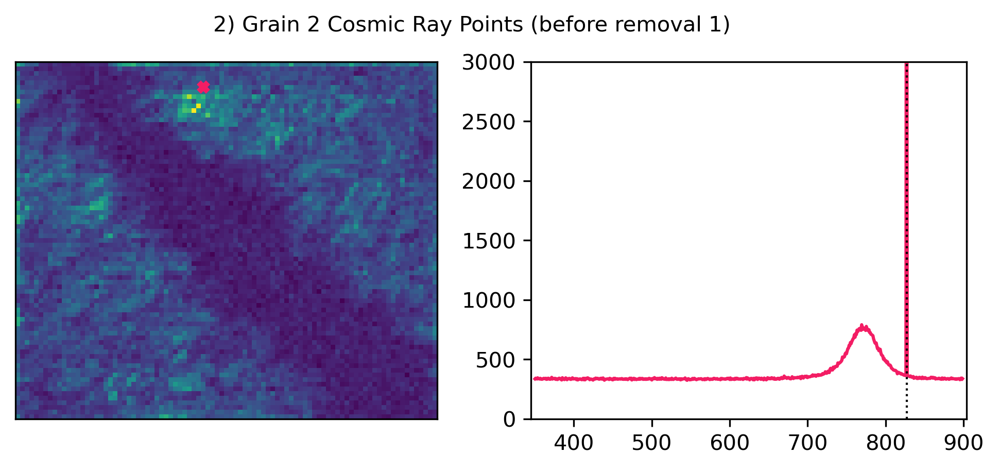

In [14]:
cosmic_gif("2) Grain 2 Cosmic Ray Points (before removal 1)", f2_img2, 780, f2_cosmic_pts_1, f2_wav)

#### Extra Plot Code

In [ ]:
# This plots all the points at once, but can often be too large
def cosmic_plot(suptitle, img, spect_point, cosmic_points, wav):
    
    rows = len(cosmic_points)
    columns = 2
    fig = plt.figure(figsize=(20, 3*rows))
    #fig.suptitle(suptitle, fontsize=30)
    gs = GridSpec(rows, columns)
    
    row_count = 0
    for i in range(rows):
        # img
        fig_img = fig.add_subplot(gs[row_count,0])
        fig_img.imshow(img[spect_point,:,:])
        fig_img.set_title(str(cosmic_points[row_count]))
        fig_img.plot(cosmic_points[row_count][2], cosmic_points[row_count][1], "X", 
                     ms=10, c=color[row_count])

        # plt
        fig_plt = fig.add_subplot(gs[row_count,1])
        #fig_plt.set_title("Spectra")
        fig_plt.plot(wav, img[:,cosmic_points[row_count][1], cosmic_points[row_count][2]], 
                     c=color[row_count], lw=5)
        fig_plt.axvline(x=cosmic_points[row_count][0], c='black', lw=1, linestyle=':')
        
        row_count += 1

    gs.tight_layout(fig, rect=[0,0.03,1,0.95])
    plt.show()

# This plots all the cosmic points in a single GIF to be quickly analyzed
def cosmic_gif1(suptitle, img, spect_pt, cosmic_pts, wav):
    
    if len(cosmic_pts) == 0: # If the cosmic points array is empty
        print("No cosmic rays identified")
        return
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
    fig.suptitle(suptitle, fontsize=10)
    
    ax1.imshow(img[spect_pt, :, :], animated=True)
    ax1.set_xticks([], labels=None)
    ax1.set_yticks([], labels=None)
    ax2.set_ylim(0, 3000)
    ax2.set_xlim(wav[0]-5, wav[-1]+5)
    
    frames = []
    
    def animate(i):
        im1 = ax1.plot(cosmic_pts[i][2], cosmic_pts[i][1], "X", ms=5, c=color[i])
        return im1
    
    for i in range(len(cosmic_pts)):
        
        #im1 = ax1.plot(cosmic_pts[i][2], cosmic_pts[i][1], "X", ms=5, c=color[i])
        
        im2, = ax2.plot(wav, img[:, cosmic_pts[i][1], cosmic_pts[i][2]], color=color[i], 
                        animated=True)
        #ax2.axvline(x=cosmic_pts[i][0], c='black', lw=3, linestyle=':')

        #frames.append([im1, im2])
        frames.append(im2)

    anim1 = FuncAnimation(fig, animate)
    anim2 = ArtistAnimation(fig, frames)
    plt.show()
    
# This plots all the cosmic points in a single GIF to be quickly analyzed
def cosmic_gif2(suptitle, img, spect_pt, cosmic_pts, wav):
    
    if len(cosmic_pts) == 0: # If the cosmic points array is empty
        print("No cosmic rays identified")
        return
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
    fig.suptitle(suptitle, fontsize=10)
    
    ax1.set_xticks([], labels=None)
    ax1.set_yticks([], labels=None)
    ax2.set_ylim(0, 3000)
    ax2.set_xlim(wav[0]-5, wav[-1]+5)
    
    frames = []

    #for i in range(len(cosmic_pts)):
    for i in range(len(cosmic_pts)):
        
        im1 = ax1.imshow(img[spect_pt, :, :], animated=True)
        ax1.plot(cosmic_pts[i][2], cosmic_pts[i][1], "X", ms=5, c=color[i])
        
        im2, = ax2.plot(wav, img[:, cosmic_pts[i][1], cosmic_pts[i][2]], color=color[i], 
                        animated=True)
        #ax2.axvline(x=cosmic_pts[i][0], c='black', lw=3, linestyle=':')

        frames.append([im1, im2])

    anim = ArtistAnimation(fig, frames)
    plt.show()

#### Old plots

With jump2 = 2.5; no jump1

F1: [[0, 29, 123], [2, 109, 8], [76, 60, 133], [79, 82, 68], [97, 25, 3], [117, 68, 56], [130, 35, 39], [132, 66, 74], [142, 110, 26], [143, 94, 148], [351, 119, 91], [355, 97, 2], [396, 27, 118], [422, 98, 105], [438, 114, 102], [463, 110, 62], [529, 66, 127], [552, 121, 121], [571, 65, 90], [590, 86, 26], [598, 39, 131], [624, 87, 70], [626, 103, 144], [634, 89, 155], [753, 121, 17], [818, 107, 47], [867, 67, 74], [870, 104, 29], [929, 55, 4], [929, 87, 32], [942, 65, 91], [980, 94, 24], [1019, 82, 111]]

F2: [[19, 45, 26], [20, 45, 26], [25, 20, 53], [41, 13, 65], [59, 65, 45], [65, 13, 65], [66, 57, 14], [80, 23, 74], [93, 23, 21], [97, 6, 20], [110, 52, 20], [122, 48, 11], [135, 61, 32], [148, 76, 65], [161, 38, 25], [199, 23, 21], [209, 3, 61], [214, 72, 12], [215, 30, 89], [220, 40, 0], [221, 40, 0], [223, 61, 4], [224, 68, 4], [227, 62, 17], [230, 68, 13], [236, 19, 44], [245, 27, 61], [248, 33, 54], [249, 33, 54], [254, 9, 13], [258, 27, 56], [291, 61, 4], [294, 44, 61], [294, 64, 14], [296, 11, 73], [296, 67, 49], [297, 11, 73], [297, 12, 31], [298, 12, 31], [311, 2, 14], [329, 48, 87], [332, 44, 50], [333, 61, 42], [335, 73, 42], [363, 43, 24], [377, 21, 63], [379, 21, 63], [386, 75, 0], [390, 48, 40], [398, 24, 0], [401, 43, 24], [415, 11, 45], [416, 66, 89], [446, 16, 2], [454, 44, 90], [460, 27, 73], [464, 7, 23], [469, 1, 33], [470, 1, 33], [479, 22, 14], [499, 22, 77], [503, 42, 2], [539, 26, 6], [566, 22, 39], [577, 21, 61], [591, 38, 76], [612, 22, 8], [630, 66, 89], [632, 59, 86], [633, 59, 86], [634, 60, 64], [652, 62, 45], [656, 59, 2], [674, 26, 53], [712, 44, 58], [755, 57, 56], [764, 71, 39], [778, 5, 40], [851, 14, 33], [884, 2, 6], [918, 30, 79], [919, 30, 79], [927, 6, 32], [932, 67, 69], [939, 55, 34], [955, 10, 26], [963, 51, 7], [964, 52, 0], [965, 52, 0], [967, 62, 56], [968, 62, 56]]

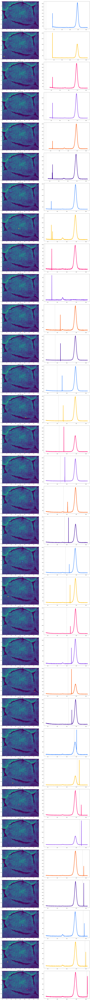

In [20]:
#cosmic_plot("Figure 1", f1_img2, 710, f1_cosmic_points, f1_wav)

In [21]:
#cosmic_plot("Figure 2", f2_img2, 405, f2_cosmic_points, f2_wav)

### Removing cosmic rays 1

First, let's plot a single cosmic ray to get an idea of how many wavelengths they typically affect.

This one appears to only affect wavelengths with a maximum radius of 2 from the identified point, so setting a radius of 5 in the cosmic ray remover should be more than enough.

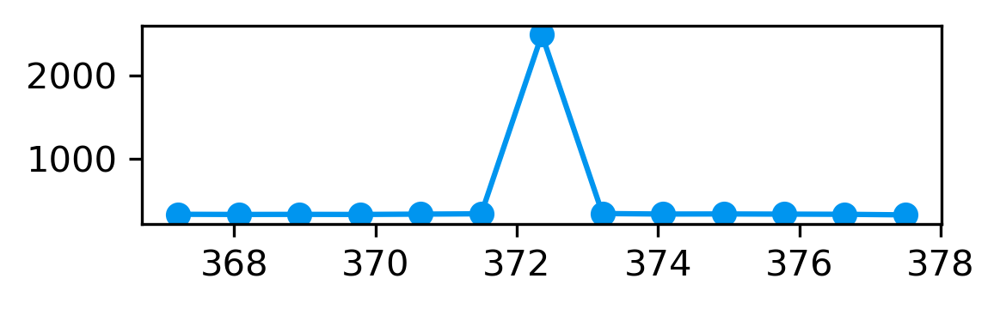

In [15]:
z_b = 20
z_t = 33
y = 27
x = 61

plt.figure(figsize=(4,1))
plt.plot(f2_wav[z_b:z_t], f2_img2[z_b:z_t, y, x], c=color[0])
plt.scatter(f2_wav[z_b:z_t], f2_img2[z_b:z_t, y, x], c=color[0])
plt.show()

This remover takes the x and y coordinates of the detected points (in the image dimension) and makes the spectral wavelengths within a radius of 4 wavelengths from the identified point the mean of the surrounding 8 points at those exact wavelengths.

In [16]:
def cosmic_ray_remover(img, zpix, cosmic_pts, radius=5):
    
    wavs_changed = 0 # Number of wavelengths in the array changed
    
    for pt in cosmic_pts:
        
        bottom = radius
        top = radius
        
        while bottom >= 0: # making sure bottom of range isn't less than 0
            if pt[0]-bottom >= 0:
                range_bottom = pt[0]-bottom
                break
            bottom -= 1
            
        while top >= 0: # making sure top of range isn't greater than length of z dimension
            if pt[0]+top <= zpix:
                range_top = pt[0]+top
                break
            top -= 1
        
        for z in range(range_bottom, range_top):
            
            try: pix1 = img[z,pt[1],pt[2]-1]
            except: pix1 = img[z,pt[1],pt[2]+1]
            try: pix2 = img[z,pt[1],pt[2]+1]
            except: pix2 = img[z,pt[1],pt[2]-1]
            try: pix3 = img[z,pt[1]-1,pt[2]]
            except: pix4 = img[z,pt[1]+1,pt[2]]
            try: pix4 = img[z,pt[1]+1,pt[2]]
            except: pix4 = img[z,pt[1]-1,pt[2]]
            try: pix5 = img[z,pt[1]-1,pt[2]-1]
            except: pix5 = img[z,pt[1]+1,pt[2]+1]
            #except: pix5 = img[z,pt[1]-1,pt[2]+1]
            try: pix6 = img[z,pt[1]-1,pt[2]+1]
            except: pix6 = img[z,pt[1]+1,pt[2]-1]
            #except: pix6 = img[z,pt[1]-1,pt[2]-1]
            try: pix7 = img[z,pt[1]+1,pt[2]-1]
            except: pix7 = img[z,pt[1]-1,pt[2]+1]
            #except: pix7 = img[z,pt[1]+1,pt[2]+1]
            try: pix8 = img[z,pt[1]+1,pt[2]+1]
            except: pix8 = img[z,pt[1]-1,pt[2]-1]
            #except: pix8 = img[z,pt[1]+1,pt[2]-1]
                
            img[z,pt[1],pt[2]] = np.mean((pix1, pix2, pix3, pix4, pix5, pix6, pix7, pix8))
            
            wavs_changed += 1
        
    return img, wavs_changed

Removing cosmic rays 1

In [17]:
f1_img2, f1_wavs_changed_1 = cosmic_ray_remover(f1_img2, f1_zpix, f1_cosmic_pts_1)
f2_img2, f2_wavs_changed_1 = cosmic_ray_remover(f2_img2, f2_zpix, f2_cosmic_pts_1)

### Plot 1 (after removal)

In [18]:
cosmic_gif("3) Grain 1 Cosmic Ray Points (after removal 1)", f1_img2, 780, f1_cosmic_pts_1, f1_wav)

No cosmic rays identified


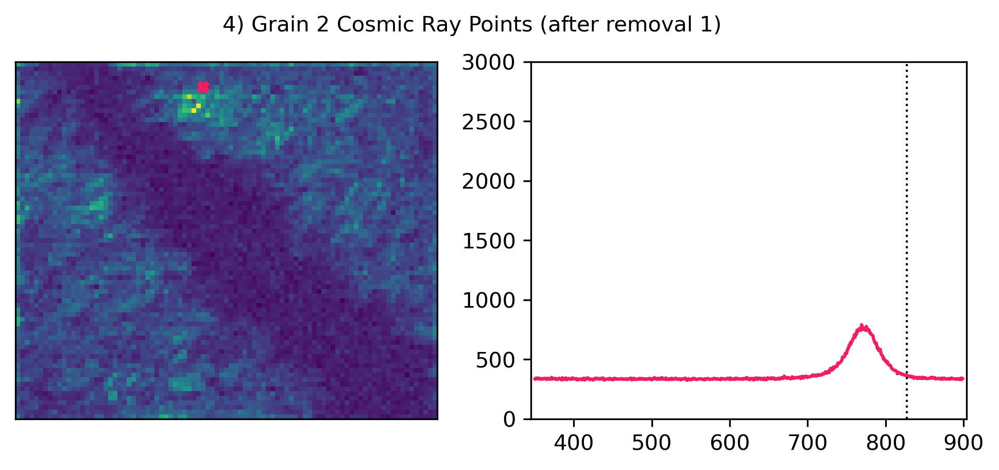

In [19]:
cosmic_gif("4) Grain 2 Cosmic Ray Points (after removal 1)", f2_img2, 780, f2_cosmic_pts_1, f2_wav)

#### Old plots

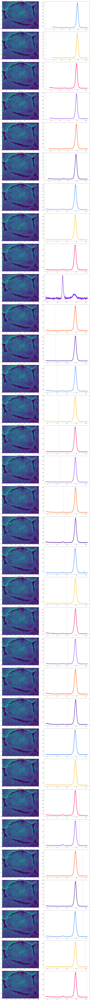

In [25]:
#cosmic_plot("Figure 1", f1_img2, 710, f1_cosmic_points, f1_wav)

In [26]:
#cosmic_plot("Figure 2", f2_img2, 405, f2_cosmic_points, f2_wav)

### Finding Cosmic Rays 2

In [20]:
def cosmic_ray_finder_2(img, jump2): # Spectral dimension
    # Identifies the rest of the pixels affected by cosmic rays and returns a list of points
    
    pts = []
    
    for z in range(len(img)):
        for y in range(len(img[z])):
            for x in range(len(img[z][y])):
                
                if z == 0: # First wavelength
                    if (img[z,y,x] > jump2*(img[z+1,y,x])):
                        pts.append([z,y,x])
                        
                elif z == (len(img)-1): # Last wavelength
                    if (img[z,y,x] > jump2*(img[z-1,y,x])):
                        pts.append([z,y,x])
                        
                else:
                    if (img[z,y,x] > jump2*(img[z-1,y,x]) or img[z,y,x] > jump2*(img[z+1,y,x])):
                        pts.append([z,y,x])
                    
    return pts

In [21]:
f1_cosmic_pts_2 = cosmic_ray_finder_2(f1_img2, 2)
f2_cosmic_pts_2 = cosmic_ray_finder_2(f2_img2, 2)
print("Grain 1 cosmic points: ", f1_cosmic_pts_2, "\nGrain 2 cosmic points: ", f2_cosmic_pts_2)

Grain 1 cosmic points:  [[11, 97, 123], [36, 22, 69], [49, 79, 54], [63, 79, 54], [70, 83, 25], [82, 53, 17], [89, 1, 110], [114, 106, 123], [132, 119, 91], [136, 97, 2], [155, 23, 116], [177, 27, 118], [199, 45, 2], [203, 98, 105], [203, 108, 29], [219, 114, 102], [244, 110, 62], [252, 62, 110], [255, 62, 110], [265, 91, 100], [266, 91, 100], [310, 66, 127], [313, 66, 127], [321, 16, 129], [322, 16, 129], [333, 121, 121], [352, 65, 90], [371, 86, 26], [372, 86, 26], [379, 39, 131], [405, 87, 70], [407, 103, 144], [408, 103, 144], [415, 89, 155], [428, 68, 159], [437, 68, 159], [463, 27, 89], [477, 74, 144], [534, 121, 17], [541, 13, 119], [552, 7, 146], [565, 63, 113], [599, 107, 47]] 
Grain 2 cosmic points:  [[4, 61, 4], [5, 68, 4], [8, 62, 17], [17, 19, 44], [18, 19, 44], [35, 9, 13], [36, 9, 13], [39, 27, 56], [63, 44, 50], [64, 44, 50], [72, 61, 4], [75, 44, 61], [75, 64, 14], [100, 33, 40], [101, 33, 40], [109, 48, 87], [110, 48, 87], [111, 48, 87], [113, 44, 50], [114, 61, 42], 

### Plot 2 (before removal)

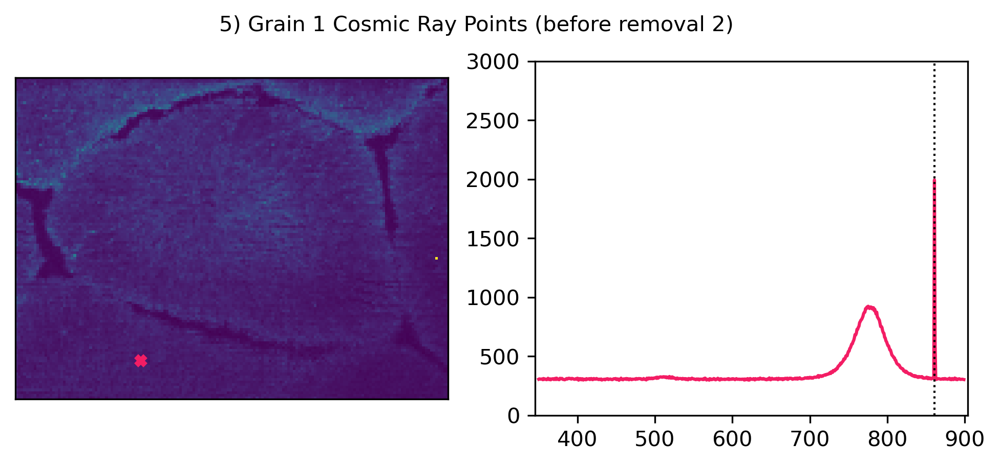

In [22]:
cosmic_gif("5) Grain 1 Cosmic Ray Points (before removal 2)", f1_img2, 780, f1_cosmic_pts_2, f1_wav)

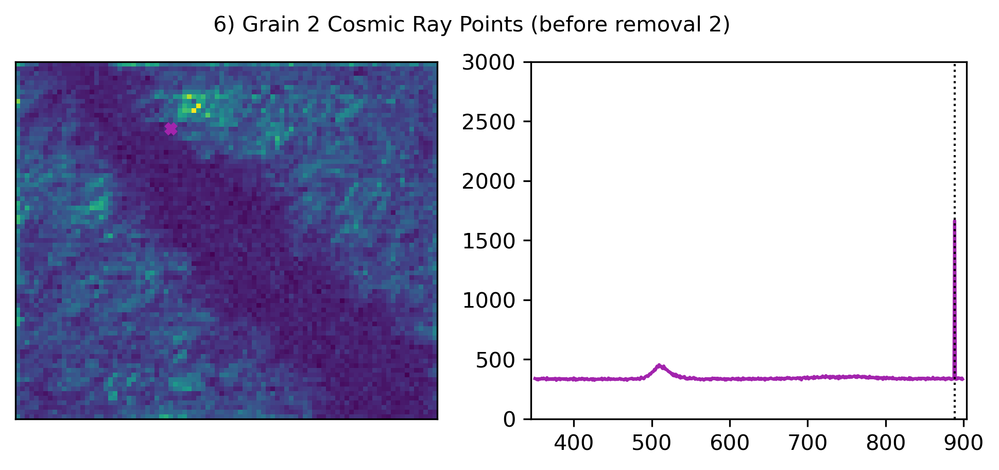

In [23]:
cosmic_gif("6) Grain 2 Cosmic Ray Points (before removal 2)", f2_img2, 780, f2_cosmic_pts_2, f2_wav)

### Removing cosmic rays 2

In [24]:
f1_img2, f1_wavs_changed_2 = cosmic_ray_remover(f1_img2, f1_zpix, f1_cosmic_pts_2)
f2_img2, f2_wavs_changed_2 = cosmic_ray_remover(f2_img2, f2_zpix, f2_cosmic_pts_2)

### Plot 2 (after removal)

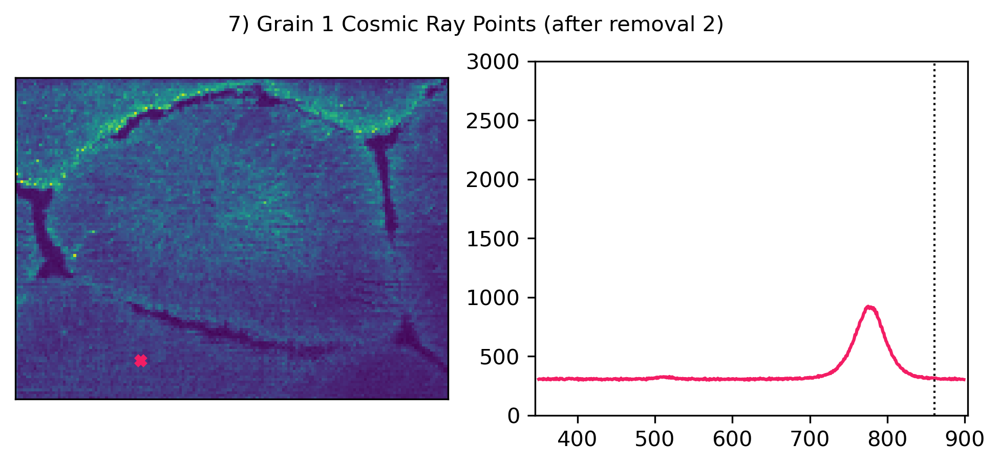

In [25]:
cosmic_gif("7) Grain 1 Cosmic Ray Points (after removal 2)", f1_img2, 780, f1_cosmic_pts_2, f1_wav)

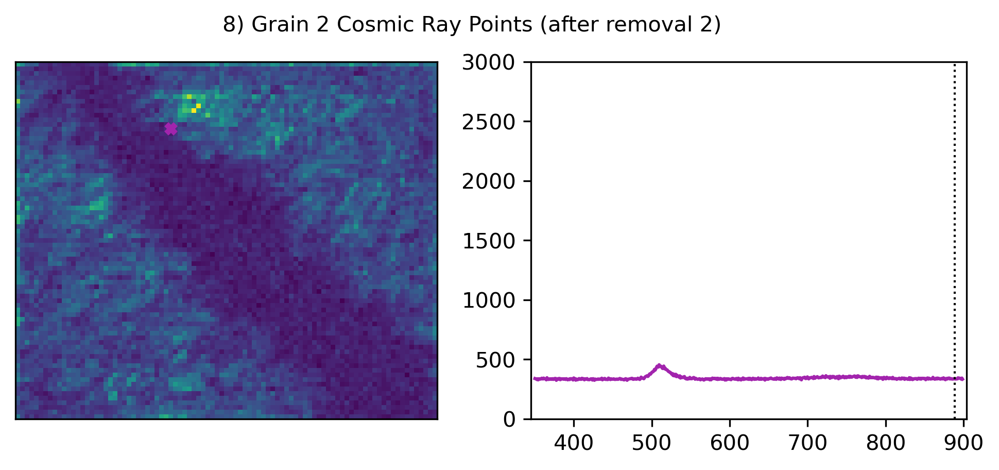

In [26]:
cosmic_gif("8) Grain 2 Cosmic Ray Points (after removal 2)", f2_img2, 780, f2_cosmic_pts_2, f2_wav)

### Testing cosmic ray detection in reverse order

In [27]:
f1_img2_test = acquisition(f1["/Acquisition2"]).image
f1_img2_2d_test = np.reshape(f1_img2_test, (f1_zpix_orig, f1_ypix*f1_xpix))

f2_img2_test = acquisition(f2["/Acquisition2"]).image
f2_img2_2d_test = np.reshape(f2_img2_test, (f2_zpix_orig, f2_ypix*f2_xpix))

f1_wav_test, f1_img2_cropped_test, f1_zpix_test = cropper(f1_wav_orig, f1_img2_2d_test, 
                                                          short_wav, long_wav)
f2_wav_test, f2_img2_cropped_test, f2_zpix_test = cropper(f2_wav_orig, f2_img2_2d_test, 
                                                          short_wav, long_wav)

f1_img2_test = np.reshape(f1_img2_cropped_test, (f1_zpix_test, f1_ypix, f1_xpix))
f2_img2_test = np.reshape(f2_img2_cropped_test, (f2_zpix_test, f2_ypix, f2_xpix))

f1_cosmic_pts_2_test = cosmic_ray_finder_2(f1_img2_test, 2)
f2_cosmic_pts_2_test = cosmic_ray_finder_2(f2_img2_test, 2)
#print("Grain 1 cosmic points: ", f1_cosmic_pts_2_test, "\nGrain 2 cosmic points: ", f2_cosmic_pts_2_test)

f1_img2_test, f1_wavs_changed_2_test = cosmic_ray_remover(f1_img2_test, f1_zpix, 
                                                          f1_cosmic_pts_2_test)
f2_img2_test, f2_wavs_changed_2_test = cosmic_ray_remover(f2_img2_test, f2_zpix, 
                                                          f2_cosmic_pts_2_test)

f1_cosmic_pts_1_test = cosmic_ray_finder_1(f1_img2_test, 7)
f2_cosmic_pts_1_test = cosmic_ray_finder_1(f2_img2_test, 7)
#print("Grain 1 cosmic points: ", f1_cosmic_pts_1_test, "\nGrain 2 cosmic points: ", f2_cosmic_pts_1_test)

f1_img2_test, f1_wavs_changed_1_test = cosmic_ray_remover(f1_img2_test, f1_zpix, 
                                                          f1_cosmic_pts_1_test)
f2_img2_test, f2_wavs_changed_1_test = cosmic_ray_remover(f2_img2_test, f2_zpix, 
                                                          f2_cosmic_pts_1_test)

### Showing percentage of data changed by cosmic ray remover

Grain 1 fraction of wavelengths changed from first removal : 0.0 
 Grain 1 fraction of wavelengths changed from second removal : 3.332000533120085e-05 
 Grain 2 fraction of wavelengths changed from first removal : 9.315158816819946e-05 
 Grain 2 fraction of wavelengths changed from second removal : 0.00012368583797155226 
 

Grain 1 fraction of wavelengths changed from first removal : 0.0 
 Grain 1 fraction of wavelengths changed from second removal : 3.332000533120085e-05 
 Grain 2 fraction of wavelengths changed from first removal : 0.0 
 Grain 2 fraction of wavelengths changed from second removal : 0.000245601574505229 



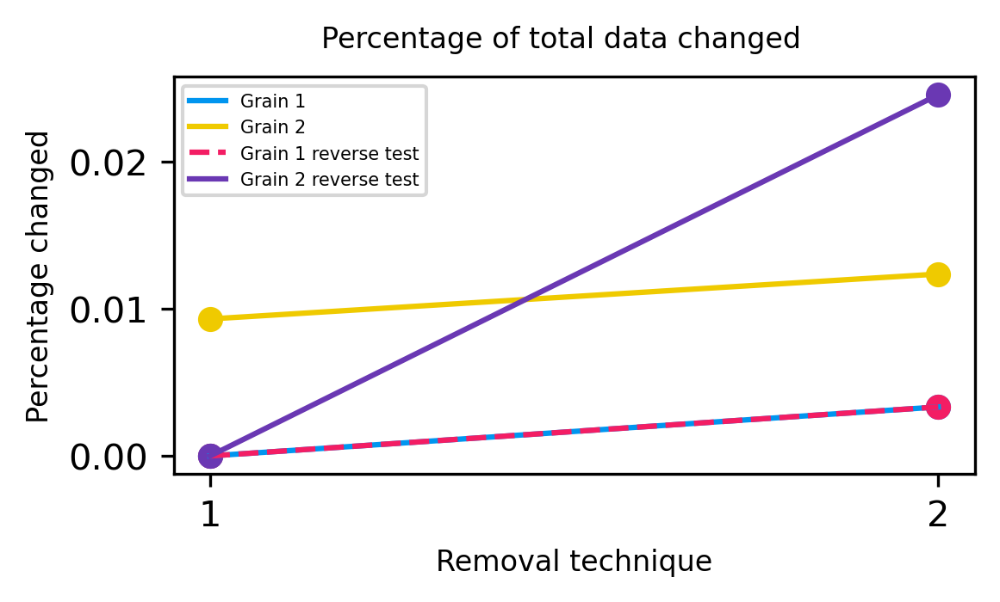

In [28]:
f1_perc_1 = f1_wavs_changed_1/f1_pix
f1_perc_2 = f1_wavs_changed_2/f1_pix
f2_perc_1 = f2_wavs_changed_1/f2_pix
f2_perc_2 = f2_wavs_changed_2/f2_pix

print("Grain 1 fraction of wavelengths changed from first removal :", f1_perc_1, "\n", 
      "Grain 1 fraction of wavelengths changed from second removal :", f1_perc_2, "\n", 
      "Grain 2 fraction of wavelengths changed from first removal :", f2_perc_1, "\n",
      "Grain 2 fraction of wavelengths changed from second removal :", f2_perc_2, "\n", "\n")

f1_perc_1_test = f1_wavs_changed_1_test/f1_pix
f1_perc_2_test = f1_wavs_changed_2_test/f1_pix
f2_perc_1_test = f2_wavs_changed_1_test/f2_pix
f2_perc_2_test = f2_wavs_changed_2_test/f2_pix

print("Grain 1 fraction of wavelengths changed from first removal :", f1_perc_1_test, "\n", 
      "Grain 1 fraction of wavelengths changed from second removal :", f1_perc_2_test, "\n", 
      "Grain 2 fraction of wavelengths changed from first removal :", f2_perc_1_test, "\n",
      "Grain 2 fraction of wavelengths changed from second removal :", f2_perc_2_test, "\n")

fontsize = 8
linestyle='-'
alpha=1

fig, ax = plt.subplots(figsize=(4, 2))
fig.suptitle("Percentage of total data changed", fontsize=fontsize)
ax.plot([1, 2], [f1_perc_1*100, f1_perc_2*100], color=color[0], linestyle=linestyle, alpha=alpha)
ax.plot([1, 2], [f2_perc_1*100, f2_perc_2*100], color=color[1], linestyle=linestyle, alpha=alpha)
ax.plot([1, 2], [f1_perc_1_test*100, f1_perc_2_test*100], color=color[2], 
        linestyle='--', alpha=alpha)
ax.plot([1, 2], [f2_perc_1_test*100, f2_perc_2_test*100], color=color[3], 
        linestyle=linestyle, alpha=alpha)
ax.scatter([1, 2], [f1_perc_1*100, f1_perc_2*100], color=color[0], alpha=alpha)
ax.scatter([1, 2], [f2_perc_1*100, f2_perc_2*100], color=color[1], alpha=alpha)
ax.scatter([1, 2], [f1_perc_1_test*100, f1_perc_2_test*100], color=color[2], alpha=alpha)
ax.scatter([1, 2], [f2_perc_1_test*100, f2_perc_2_test*100], color=color[3], alpha=alpha)
ax.set_xlabel("Removal technique", fontsize=fontsize)
ax.set_ylabel("Percentage changed", fontsize=fontsize)
ax.set_xticks([1, 2])
ax.legend(["Grain 1", "Grain 2", "Grain 1 reverse test", "Grain 2 reverse test"], fontsize=5)
#fig.savefig(save_directory + "cosmic-rays/Percentage of total data changed after removal" + file_extension)
plt.show()

## Reshaping

Reshaping image from 3D to 1D, and reshaping image from 3D to 2D

In [29]:
f1_img2_1d = np.reshape(f1_img2, (f1_zpix*f1_ypix*f1_xpix), order='C')
f2_img2_1d = np.reshape(f2_img2, (f2_zpix*f2_ypix*f2_xpix), order='C')
print(f1_img2_1d.shape)
print(f2_img2_1d.shape)

# n_samples = 645, n_features = 20008
f1_img2_2d = np.reshape(f1_img2, (f1_zpix, f1_ypix*f1_xpix), order='C')

# n_samples = 645, n_features = 7007
f2_img2_2d = np.reshape(f2_img2, (f2_zpix, f2_ypix*f2_xpix), order='C')

print(f1_img2_2d.shape)
print(f2_img2_2d.shape)

(12905160,)
(4519515,)
(645, 20008)
(645, 7007)


## Extra

#### Dataset 1

In [ ]:
#f1.keys()

In [ ]:
#print(str(acquisition(f1["Acquisition0"]).name) + ', ' +
#str(acquisition(f1["Acquisition1"]).name) + ', ' +
#str(acquisition(f1["Acquisition2"]).name) + ', ' +
#str(acquisition(f1["Acquisition3"]).name))
# Only Acquisitions 1 and 2 are relevant

In [ ]:
#f1["Acquisition1"].keys()

In [ ]:
#f1["Acquisition1"]["ImageData"].keys()

In [ ]:
#f1["Acquisition1"]["PhysicalData"].keys()

In [ ]:
#f1["Acquisition1"]["SVIData"].keys()

In [ ]:
#f1["Acquisition1"]["StateEnumeration"].keys()

In [ ]:
#f1["Acquisition2"].keys()

In [ ]:
#f1["Acquisition2"]["ImageData"].keys()

In [ ]:
#f1["Acquisition2"]["PhysicalData"].keys()

In [ ]:
#plt.imshow(f1_img1)
#plt.show()

In [ ]:
#f1_img1.shape

In [ ]:
#f1["Acquisition1"]["ImageData"]["DimensionScaleX"][()]

In [ ]:
#f1["Acquisition2"]["ImageData"]["DimensionScaleC"][()] * 1e9

In [ ]:
# Transpose
#plt.plot(f1_img2[:,100,100])
#plt.plot(f1_img2.T[:,100,100], c='b')
#plt.show()

#### Dataset 2

In [ ]:
#f2.keys()

In [ ]:
#print(str(acquisition(f2["Acquisition0"]).name) + ', ' +
#str(acquisition(f2["Acquisition1"]).name) + ', ' +
#str(acquisition(f2["Acquisition2"]).name) + ', ' +
#str(acquisition(f2["Acquisition3"]).name))

In [ ]:
#f2["Acquisition1"].keys()

In [ ]:
#f2["Acquisition2"]["ImageData"].keys()

In [ ]:
#plt.imshow(f2_img1)
#plt.show()

In [ ]:
#f2_img1.shape

# Initial Plots

These plots show the SEM image (left), the CL image (center) along with 4 unique spectra chosen and plotted with corresponding colors (right). The horizontal black bar in the spectral plots show the point in the spectra shown in the CL image (Figure 1 is at 715 nm)

## Plot Code

In [30]:
f1_x_points = [50, 10, 142, 53]
f1_y_points = [50, 65, 22, 89]

f2_x_points = [70, 10, 58, 55]
f2_y_points = [10, 67, 40, 40]

In [61]:
def initial_plot(suptitle, img1, img2, spect_pt, x_points, y_points, wav, 
                 scalebar_size, save=False):
    
    fig = plt.figure(figsize=(9, 2))
    rows = 1
    columns = 3
    gs = GridSpec(rows, columns)
    gs.update(wspace=0.1,hspace=0.1, top=0.75)

    fig.suptitle(suptitle, fontsize=10)
    #fig.patch.set_facecolor('#00000000')

    # img1
    fig_img1 = fig.add_subplot(gs[0,0])
    fig_img1.imshow(img1[:,:], cmap='gray')
    fig_img1.set_title("SEM Image", fontsize=8)
    fig_img1.set_xticks([])
    fig_img1.set_yticks([])

    # img2
    fig_img2 = fig.add_subplot(gs[0,1])
    fig_img2.imshow(img2[spect_pt-short_wav,:,:])
    fig_img2.set_title("CL Image", fontsize=8)
    fig_img2.set_xticks([])
    fig_img2.set_yticks([])
    scalebar = AnchoredSizeBar(fig_img2.transData, scalebar_size, " ", "lower right",
                           pad=0.3,
                           color='#F2F2F2',
                           frameon=False,
                           size_vertical=2,
                           label_top=True)
    fig_img2.add_artist(scalebar)
    
    count = 0
    for i in range(len(x_points)):
        fig_img2.plot(x_points[count], y_points[count], "o", ms=4, c=color[i])
        count += 1

    # plt
    fig_plt = fig.add_subplot(gs[0,2:])
    fig_plt.set_title("Spectra", fontsize=8)
    #fig_plt.set_xticks([400-short_wav, 750-long_wav])
    #fig_plt.set_yticks([400, 800])
    #fig_plt.set_xticklabels([])
    #fig_plt.set_yticklabels([])
    plt.xlim(short_wav-5, long_wav+5)
    fig_plt.tick_params(axis='both', direction='out', length=4, width=1, labelsize=5)
    
    count = 0
    for i in range(len(x_points)):
        fig_plt.plot(wav, img2[:, y_points[count], x_points[count]], 
                     c=color[i], lw=1.5)
        #print(np.shape(img2[:, y_points[count], x_points[count]]))
        count += 1

    fig_plt.axvline(x=spect_pt-short_wav, c='black',lw=1, linestyle=':')
    
    if save:
        fig.savefig(save_directory + suptitle + file_extension)
    plt.show()

## Grain 1

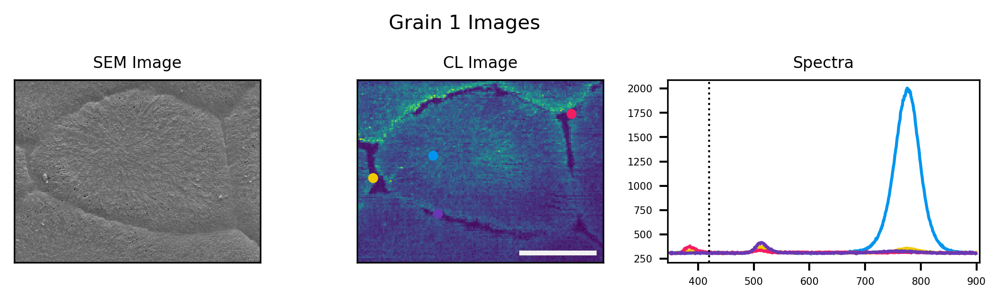

In [62]:
initial_plot("Grain 1 Images", f1_img1, f1_img2, 770, f1_x_points, f1_y_points, f1_wav, 50)

In [ ]:
#print("Colorbar Length:{} micrometers".format(ds1.meas2.ydim*50*1e6))

## Grain 2

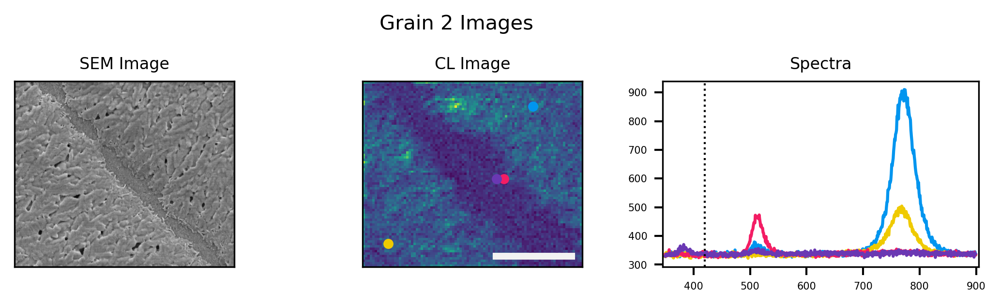

In [63]:
initial_plot("Grain 2 Images", f2_img1, f2_img2, 770, f2_x_points, f2_y_points, f2_wav, 33.333333333)

In [ ]:
#print("Colorbar Length:{} micrometers".format(ds2.meas2.ydim*33.333333333*1e6))

## Color bar

In [358]:
def color_bar():
    a = np.array([[0,1]])
    fig = plt.figure(figsize=(1.5, 9))
    fig.patch.set_facecolor('#00000000')
    img = plt.imshow(a)
    plt.gca().set_visible(False)
    cax = plt.axes([0.1, 0.2, 0.8, 0.6])
    cbar = plt.colorbar(orientation="vertical", cax=cax, ticks=[0.004,0.5,0.995])
    cbar.ax.set_yticklabels([])
    cbar.ax.tick_params(axis='both', direction='out', length=12, width=4)
    #fig.savefig('Graphs/final/0.2) Colorbar.svg')

#color_bar()

## Hyperspectral image graphic

In [361]:
def hs_img_graphic(img, pt):
    fig, ax = plt.subplots()
    cmap = mpl.cm.Purples(np.linspace(0,1,20))
    cmap = mpl.colors.ListedColormap(cmap[10:,:-1])
    ax.imshow(img[pt,:,:], cmap=cmap)
    fig.patch.set_facecolor('#00000000')
    ax.set_xticks([])
    ax.set_yticks([])
    #fig.savefig('Graphs/final/0.1e) HS graphic purple image.svg')
    plt.show()
    
#hs_img_graphic(f1_img2, 730)

# Denoising

Various denoising techniques employed:
1. Subtracting background noise (average value of first 100 pixels) from entire array and setting negative values to zero
2. Median filter that makes each wavelength in a spectrum the median of the surrounding points (window size as a specified parameter)
3. Savitzky-Golay filter uses convolution by fitting successive sub-sets of adjacent data points with a low-degree polynomial by the method of linear least squares
4. Gaussian filter takes the weighted average of surrounding pixels based on a Gaussian distribution
5. Wavelet filter decomposes the spectra into approximated parts and reconstructs a smoothed-out spectrum

## Techniques

### Grain 1

In [34]:
# Subtract background
f1_sb_mean = np.mean(f1_img2_1d[0:100])
f1_sub_back = [(i - f1_sb_mean) for i in f1_img2_1d]
f1_sub_back = [i.clip(min=0) for i in f1_sub_back]
f1_sub_back = np.reshape(f1_sub_back, (f1_zpix, f1_ypix, f1_xpix), order='C')

# SB + Median
f1_sub_back_1d = np.reshape(f1_sub_back, (f1_zpix*f1_ypix*f1_xpix), order='C')
f1_sb_median = median_filter(
    f1_sub_back_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_sb_median = np.reshape(f1_sb_median, (f1_zpix, f1_ypix, f1_xpix), order='C')

In [35]:
# Median filter
f1_1d_median = median_filter(
    f1_img2_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_median = np.reshape(f1_1d_median, (f1_zpix, f1_ypix, f1_xpix), order='C')
# Finding median (nonlinear)
# Changing the mode appears to have no affect on the spectra
# (Mode options: reflect, constant, nearest, mirror, wrap)

# Savitzky-Golay filter
f1_1d_savgol = savgol_filter(
    f1_img2_1d, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f1_savgol = np.reshape(f1_1d_savgol, (f1_zpix, f1_ypix, f1_xpix), order='C')
# Convolution (linear)
# The larger the window length, the more similar the spectra become;
# increasing polynomial order makes the spectra noisier
# (Mode options: interp, constant, nearest, mirror, wrap)

# Fast Fourier Transform
#f1_1d_fft = np.fft.fft(f1_img2_1d, n=None, axis=-1, norm=None)
#f1_fft = np.reshape(f1_1d_fft, (f1_zpix, f1_ypix, f1_xpix), order='C')

# Gaussian filter
f1_sigma = np.std(f1_img2_1d)
f1_1d_gauss = gaussian_filter(f1_img2_1d, 
    f1_sigma, order=0, output=None, mode='reflect', cval=0.0, truncate=4.0)
f1_gauss = np.reshape(f1_1d_gauss, (f1_zpix, f1_ypix, f1_xpix), order='C')
# (Mode options: reflect, constant, nearest, mirror, wrap)

# Wavelet filter
f1_1d_wavelet = denoise_wavelet(f1_img2_1d, 
    method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym8', rescale_sigma='True')
f1_wavelet = np.reshape(f1_1d_wavelet, (f1_zpix, f1_ypix, f1_xpix), order='C')
#for i in f1_wavelet:
    #i *= 10e4
    
# Median + Savitzky-Golay
f1_1d_median_a = median_filter(
    f1_img2_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_1d_median_savgol = savgol_filter(
    f1_1d_median_a, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f1_median_savgol = np.reshape(f1_1d_median_savgol, (f1_zpix, f1_ypix, f1_xpix), order='C')

# Savitzky-Golay + Median
f1_1d_savgol_a = savgol_filter(
    f1_img2_1d, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f1_1d_savgol_median = median_filter(
    f1_1d_savgol_a, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_savgol_median = np.reshape(f1_1d_savgol_median, (f1_zpix, f1_ypix, f1_xpix), order='C')

# Median + Savitzky-Golay + Gaussian
f1_1d_median_b = median_filter(
    f1_img2_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_1d_median_savgol_b = savgol_filter(
    f1_1d_median_b, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f1_median_savgol_sigma = np.std(f1_1d_median_savgol_b)
f1_1d_median_savgol_gauss = gaussian_filter(f1_1d_median_savgol_b, 
    f1_median_savgol_sigma, order=0, output=None, mode='reflect', cval=0.0, truncate=4.0)
f1_median_savgol_gauss = np.reshape(f1_1d_median_savgol_gauss, (f1_zpix, f1_ypix, f1_xpix), order='C')

# Median + Savitzky-Golay + Wavelet
f1_1d_median_c = median_filter(
    f1_img2_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_1d_median_savgol_c = savgol_filter(
    f1_1d_median_c, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f1_1d_median_savgol_wavelet = denoise_wavelet(f1_1d_median_savgol_c, 
    method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym8', rescale_sigma='True')
f1_median_savgol_wavelet = np.reshape(f1_1d_median_savgol_wavelet, 
                                      (f1_zpix, f1_ypix, f1_xpix), order='C')

# Savitzky-Golay + Median + Wavelet
f1_1d_savgol_d = savgol_filter(
    f1_img2_1d, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f1_1d_savgol_median_d = median_filter(
    f1_1d_savgol_d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_1d_savgol_median_wavelet = denoise_wavelet(f1_1d_savgol_median_d, 
    method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym8', rescale_sigma='True')
f1_savgol_median_wavelet = np.reshape(f1_1d_savgol_median_wavelet, 
                                    (f1_zpix, f1_ypix, f1_xpix), order='C')

# Median + Wavelet
f1_1d_median_e = median_filter(
    f1_img2_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_1d_median_wavelet = denoise_wavelet(f1_1d_median_e, 
    method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym8', rescale_sigma='True')
f1_median_wavelet = np.reshape(f1_1d_median_wavelet, 
                                      (f1_zpix, f1_ypix, f1_xpix), order='C')

# Wavelet + Median
f1_1d_wavelet_f = denoise_wavelet(f1_img2_1d, 
    method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym8', rescale_sigma='True')
f1_1d_wavelet_median = median_filter(
    f1_1d_wavelet_f, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_wavelet_median = np.reshape(f1_1d_wavelet_median, 
                                      (f1_zpix, f1_ypix, f1_xpix), order='C')

# SB + Savgol
f1_sb_savgol = savgol_filter(
    f1_sub_back_1d, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f1_sb_savgol = np.reshape(f1_sb_savgol, (f1_zpix, f1_ypix, f1_xpix), order='C')

# SB + Gaussian
f1_sb_sigma = np.std(f1_sub_back_1d)
f1_sb_gauss = gaussian_filter(f1_sub_back_1d, 
    f1_sb_sigma, order=0, output=None, mode='reflect', cval=0.0, truncate=4.0)
f1_sb_gauss = np.reshape(f1_sb_gauss, (f1_zpix, f1_ypix, f1_xpix), order='C')

# SB + Wavelet
f1_sb_wavelet = denoise_wavelet(f1_sub_back_1d, 
    method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym8', rescale_sigma='True')
f1_sb_wavelet = np.reshape(f1_sb_wavelet, (f1_zpix, f1_ypix, f1_xpix), order='C')

# SB + Median + Savgol
f1_sb_median_a = median_filter(
    f1_sub_back_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_sb_median_savgol = savgol_filter(
    f1_sb_median_a, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f1_sb_median_savgol = np.reshape(f1_sb_median_savgol, (f1_zpix, f1_ypix, f1_xpix), order='C')

# Median + SB
f1_median_sb = median_filter(
    f1_img2_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f1_median_mean = np.mean(f1_median_sb[0:100])
f1_median_sb = [(i - f1_median_mean) for i in f1_median_sb]
f1_median_sb = [i.clip(min=0) for i in f1_median_sb]
f1_median_sb = np.reshape(f1_median_sb, (f1_zpix, f1_ypix, f1_xpix), order='C')

### Grain 2

In [36]:
# Subtract background
f2_sb_mean = np.mean(f2_img2_1d[0:100])
f2_sub_back = [(i - f2_sb_mean) for i in f2_img2_1d]
f2_sub_back = [i.clip(min=0) for i in f2_sub_back]
f2_sub_back = np.reshape(f2_sub_back, (f2_zpix, f2_ypix, f2_xpix), order='C')

# SB + Median
f2_sub_back_1d = np.reshape(f2_sub_back, (f2_zpix*f2_ypix*f2_xpix), order='C')
f2_sb_median = median_filter(
    f2_sub_back_1d, size=2, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f2_sb_median = np.reshape(f2_sb_median, (f2_zpix, f2_ypix, f2_xpix), order='C')

In [37]:
# Median filter
f2_1d_median = median_filter(
    f2_img2_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f2_median = np.reshape(f2_1d_median, (f2_zpix, f2_ypix, f2_xpix), order='C')

# Savitzky-Golay filter
f2_1d_savgol = savgol_filter(
    f2_img2_1d, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f2_savgol = np.reshape(f2_1d_savgol, (f2_zpix, f2_ypix, f2_xpix), order='C')

# Gaussian filter
f2_sigma = np.std(f2_img2_1d)
f2_1d_gauss = gaussian_filter(f2_img2_1d, 
    f2_sigma, order=0, output=None, mode='reflect', cval=0.0, truncate=4.0)
f2_gauss = np.reshape(f2_1d_gauss, (f2_zpix, f2_ypix, f2_xpix), order='C')

# Wavelet filter
f2_1d_wavelet = denoise_wavelet(f2_img2_1d, 
    method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym8', rescale_sigma='True')
f2_wavelet = np.reshape(f2_1d_wavelet, (f2_zpix, f2_ypix, f2_xpix), order='C')

# Median + Savitzky-Golay
f2_1d_median_a = median_filter(
    f2_img2_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f2_1d_median_savgol = savgol_filter(
    f2_1d_median_a, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f2_median_savgol = np.reshape(f2_1d_median_savgol, (f2_zpix, f2_ypix, f2_xpix), order='C')

# Savitzky-Golay + Median
f2_1d_savgol_a = savgol_filter(
    f2_img2_1d, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f2_1d_savgol_median = median_filter(
    f2_1d_savgol_a, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f2_savgol_median = np.reshape(f2_1d_savgol_median, (f2_zpix, f2_ypix, f2_xpix), order='C')

# Median + Savitzky-Golay + Wavelet
f2_1d_median_c = median_filter(
    f2_img2_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f2_1d_median_savgol_c = savgol_filter(
    f2_1d_median_c, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f2_1d_median_savgol_wavelet = denoise_wavelet(f2_1d_median_savgol_c, 
    method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym8', rescale_sigma='True')
f2_median_savgol_wavelet = np.reshape(f2_1d_median_savgol_wavelet, 
                                      (f2_zpix, f2_ypix, f2_xpix), order='C')

# Savitzky-Golay + Median + Wavelet
f2_1d_savgol_d = savgol_filter(
    f2_img2_1d, window_length=3, polyorder=1, deriv=0, delta=1.0, axis=-1, mode='interp', 
    cval=0.0)
f2_1d_savgol_median_d = median_filter(
    f2_1d_savgol_d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f2_1d_savgol_median_wavelet = denoise_wavelet(f2_1d_savgol_median_d, 
    method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym8', rescale_sigma='True')
f2_savgol_median_wavelet = np.reshape(f2_1d_savgol_median_wavelet, 
                                    (f2_zpix, f2_ypix, f2_xpix), order='C')

# Median + Wavelet
f2_1d_median_e = median_filter(
    f2_img2_1d, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f2_1d_median_wavelet = denoise_wavelet(f2_1d_median_e, 
    method='VisuShrink', mode='soft', wavelet_levels=2, wavelet='sym8', rescale_sigma='True')
f2_median_wavelet = np.reshape(f2_1d_median_wavelet, 
                                      (f2_zpix, f2_ypix, f2_xpix), order='C')

# Wavelet + Median
f2_1d_wavelet_f = denoise_wavelet(f2_img2_1d, 
    method='VisuShrink', mode='soft', wavelet_levels=2, wavelet='sym8', rescale_sigma='True')
f2_1d_wavelet_median = median_filter(
    f2_1d_wavelet_f, size=3, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f2_wavelet_median = np.reshape(f2_1d_wavelet_median, 
                                      (f2_zpix, f2_ypix, f2_xpix), order='C')

# Median + SB
f2_median_sb = median_filter(
    f2_img2_1d, size=2, footprint=None, output=None, mode='reflect', cval=0.0, origin=0)
f2_median_mean = np.mean(f2_median_sb[0:100])
f2_median_sb = [(i - f2_median_mean) for i in f2_median_sb]
f2_median_sb = [i.clip(min=0) for i in f2_median_sb]
f2_median_sb = np.reshape(f2_median_sb, (f2_zpix, f2_ypix, f2_xpix), order='C')

## Plotting Denoising Techniques

These techniques and combinations thereof are compared side-by-side

### Plot code

In [38]:
# Grain 1
f1_denoise_arrays = [f1_img2, f1_median, f1_savgol, f1_gauss, f1_wavelet, f1_median_savgol, 
              f1_savgol_median, f1_median_savgol_gauss, f1_median_savgol_wavelet, 
              f1_savgol_median_wavelet, f1_median_wavelet, f1_wavelet_median, f1_sub_back, 
              f1_sb_median, f1_sb_savgol, f1_sb_gauss, f1_sb_wavelet, f1_sb_median_savgol, 
              f1_median_sb]
f1_denoise_x_points = [50, 10, 142, 53]
f1_denoise_y_points = [50, 65, 22, 89]

f1_denoise_method_names = ["Original", "Median", "Savitzky-Golay", "Gaussian", "Wavelet", 
                    "M + SG", "SG + M", "M + SG + G", "M + SG + W", "SG + M + W", "M + W", 
                    "W + M", "Subtract background", "SB + M", "SB + SG", "SB + G", 
                    "SB + W", "SB + M + SG", "M + SB"]
f1_denoise_point_names = [" pt 1", " pt 2", " pt 3", " pt 4"]

# Grain 2
f2_denoise_arrays = [f2_img2, f2_median, f2_savgol, f2_gauss, f2_wavelet, f2_median_savgol, 
                     f2_savgol_median, f2_median_savgol_wavelet, f2_savgol_median_wavelet, 
                     f2_median_wavelet, f2_wavelet_median, f2_sub_back, f2_sb_median, 
                     f2_median_sb]
f2_denoise_x_points = [70, 10, 58, 55]
f2_denoise_y_points = [10, 67, 40, 40]

f2_denoise_method_names = ["Original", "Median", "Savitzky-Golay", "Gaussian", "Wavelet", 
                           "M + SG", "SG + M", "M + SG + W", "SG + M + W", "M + W", "W + M",
                          "Subtract background", "SG + M", "M + SG"]
f2_denoise_point_names = [" pt 1", " pt 2", " pt 3", " pt 4"]

In [50]:
# Plotting function for denoised data
def denoise_plot(suptitle, arrays, x_points, y_points, method_names, point_names, save=False):
    
    rows = len(method_names)
    columns = len(point_names)
    gs = GridSpec(rows, columns)
    gs.update(wspace=0,hspace=0.2)

    figsize = (columns*1.5, rows)
    fig = plt.figure(figsize=figsize)
    #fig.patch.set_facecolor('#00000000')
    fig.suptitle(suptitle, fontsize=10)
    fig.subplots_adjust(top=0.95, bottom=0.01)

    row_count = 0
    for i in range(rows):

        column_count = 0
        for j in range(columns):

            fig_plt = fig.add_subplot(gs[row_count,column_count])
            fig_plt.plot(arrays[row_count][:,y_points[column_count],
                        x_points[column_count]], c=color[j], lw=1)
            fig_plt.set_title(method_names[row_count] + point_names[column_count], fontsize=5)
            fig_plt.tick_params(color=color[j])
            fig_plt.set_xticks([])
            fig_plt.set_yticks([])
            
            #if column_count == 0:
                #fig_plt.set_yticks([1000])
                #fig_plt.set_yticklabels([])
                #fig_plt.tick_params(axis='y', direction='out', length=12, width=4)
            
            #if row_count == rows-1:
                #fig_plt.set_xticks([])
                #fig_plt.set_xticklabels([])
                #fig_plt.tick_params(axis='x', direction='out', length=12, width=4)

            column_count += 1

        row_count += 1
    
    if save:
        fig.savefig(save_directory + suptitle + file_extension)
    plt.show()

### Grain 1

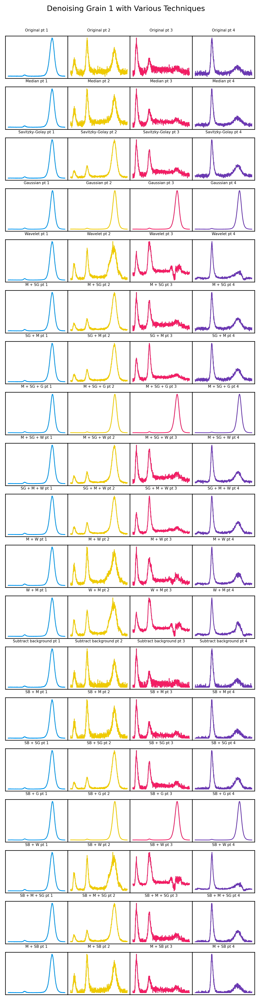

In [51]:
denoise_plot("Denoising Grain 1 with Various Techniques", f1_denoise_arrays, 
             f1_denoise_x_points, f1_denoise_y_points, f1_denoise_method_names, 
             f1_denoise_point_names)

### Grain 2

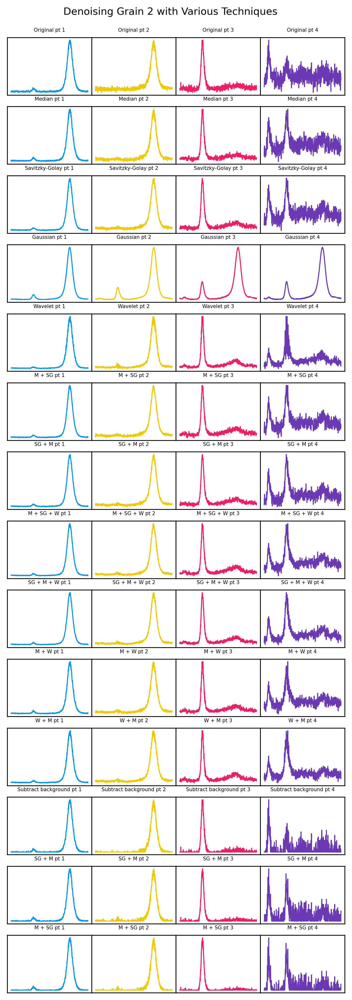

In [52]:
denoise_plot("Denoising Grain 2 with Various Techniques", f2_denoise_arrays, 
             f2_denoise_x_points, f2_denoise_y_points, f2_denoise_method_names, 
             f2_denoise_point_names)

# Reshape

In [384]:
f1_denoised_2d = np.reshape(f1_sb_median, (f1_zpix, f1_ypix*f1_xpix), order='C')
f2_denoised_2d = np.reshape(f2_sb_median, (f2_zpix, f2_ypix*f2_xpix), order='C')

In [386]:
print("SEM images: f1_img1, f2_img1")
print("CL images: f1_img2, f2_img2")
print("Denoised data: f1_sb_median, f2_sb_median")
print("2D denoised data: f1_denoised_2d, f2_denoised_2d")
print("Example points: f1_x_points, f1_y_points, f2_x_points, f2_y_points")
print("Wavelengths and dimensions: f1_wav, f2_wav, " 
      "f1_xpix, f1_ypix, f1_zpix, f2_xpix, f2_ypix, f2_zpix")

SEM images: f1_img1, f2_img1
CL images: f1_img2, f2_img2
Denoised data: f1_sb_median, f2_sb_median
2D denoised data: f1_denoised_2d, f2_denoised_2d
Example points: f1_x_points, f1_y_points, f2_x_points, f2_y_points
Wavelengths and dimensions: f1_wav, f2_wav, f1_xpix, f1_ypix, f1_zpix, f2_xpix, f2_ypix, f2_zpix
